<a href="https://colab.research.google.com/github/haeniKim/metaverse-academy/blob/master/ComputerVision/230705_actor_casting_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 배역 캐스팅 분류기

* 남자 배우

In [ ]:
%matplotlib inline
!pip install tensorboardX

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.6/101.6 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 304.5/304.5 kB 23.7 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3


In [ ]:
# SummaryWriter 인스턴스 생성
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

In [ ]:
!pip install koreanize-matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 44.9 MB/s eta 0:00:00


In [ ]:
import matplotlib.pyplot as plt
import koreanize_matplotlib

## Train, Test 데이터분리

### 구글드라이브에서 데이터 가져오기

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import shutil

directory_list = [
    '/content/drive/MyDrive/dataset/train/',
    '/content/drive/MyDrive/dataset/test/'
]

for dir in directory_list:
    if not os.path.isdir(dir):
        os.makedirs(dir)

In [ ]:
#수집한 이미지를 학습데이터 평가데이터로 구분하는 함수
def dataset_split(query,train_cnt):

    for dir in directory_list:
        if not os.path.isdir(dir+query.split('/')[-1]):
            os.makedirs(dir+query.split('/')[-1])

    cnt = 0
    for file_name in os.listdir(query):
        if cnt < train_cnt:
            print(f'trainset : {file_name}')
            shutil.move(query+'/'+file_name,'/content/drive/MyDrive/dataset/train/'+query.split('/')[-1]+'/'+file_name)
        else:
            print(f'testset : {file_name}')
            shutil.move(query+'/'+file_name,'/content/drive/MyDrive/dataset/test/'+query.split('/')[-1]+'/'+file_name)

        cnt += 1

    shutil.rmtree(query)

In [ ]:
dataset_split('/content/drive/MyDrive/dataset/왕', 320) # 400장의 이미지 train -  320장, test - 80장

trainset : choi (1).jpg
trainset : choi (10).jpg
trainset : choi (20).jpg
trainset : choi (16).jpg
trainset : choi (23).jpg
trainset : choi (2).jpg
trainset : choi (17).jpg
trainset : choi (26).jpg
trainset : choi (19).jpg
trainset : choi (13).jpg
trainset : choi (11).jpg
trainset : choi (25).jpg
trainset : choi (24).jpg
trainset : choi (12).jpg
trainset : choi (18).jpg
trainset : choi (21).jpg
trainset : choi (27).jpg
trainset : choi (14).jpg
trainset : choi (15).jpg
trainset : choi (22).jpg
trainset : choi (28).jpg
trainset : choi (29).jpg
trainset : choi (47).jpg
trainset : choi (41).jpg
trainset : choi (37).jpg
trainset : choi (33).jpg
trainset : choi (46).jpg
trainset : choi (40).jpg
trainset : choi (43).jpg
trainset : choi (48).jpg
trainset : choi (42).jpg
trainset : choi (4).jpg
trainset : choi (5).jpg
trainset : choi (34).jpg
trainset : choi (30).jpg
trainset : choi (3).jpg
trainset : choi (39).jpg
trainset : choi (32).jpg
trainset : choi (31).jpg
trainset : choi (44).jpg
train

In [ ]:
dataset_split('/content/drive/MyDrive/dataset/악역', 320)

trainset : img (33).jpg
trainset : img (84).jpg
trainset : img (44).jpg
trainset : img (48).jpg
trainset : img (83).jpg
trainset : img (46).jpg
trainset : img (50).jpg
trainset : img (87).jpg
trainset : img (49).jpg
trainset : img (81).jpg
trainset : img (43).jpg
trainset : img (85).jpg
trainset : img (82).jpg
trainset : img (47).jpg
trainset : img (86).jpg
trainset : img (42).jpg
trainset : img (34).jpg
trainset : img (51).jpg
trainset : img (45).jpg
trainset : img (53).jpg
trainset : img (93).jpg
trainset : img (90).jpg
trainset : img (89).jpg
trainset : img (64).jpg
trainset : img (62).jpg
trainset : img (55).jpg
trainset : img (66).jpg
trainset : img (60).jpg
trainset : img (52).jpg
trainset : img (56).jpg
trainset : img (58).jpg
trainset : img (92).jpg
trainset : img (59).jpg
trainset : img (65).jpg
trainset : img (57).jpg
trainset : img (63).jpg
trainset : img (35).jpg
trainset : img (54).jpg
trainset : img (91).jpg
trainset : img (88).jpg
trainset : img (61).jpg
trainset : img (

In [ ]:
dataset_split('/content/drive/MyDrive/dataset/로맨스주인공', 320)

trainset : ahn (132).jpg
trainset : ahn (10).jpg
trainset : ahn (131).jpg
trainset : ahn (129).jpg
trainset : ahn (13).jpg
trainset : ahn (109).jpg
trainset : ahn (120).jpg
trainset : ahn (106).jpg
trainset : ahn (118).jpg
trainset : ahn (102).jpg
trainset : ahn (158).jpg
trainset : ahn (202).jpg
trainset : ahn (133).jpg
trainset : ahn (2).jpg
trainset : ahn (208).jpg
trainset : ahn (15).jpg
trainset : ahn (207).jpg
trainset : ahn (200).jpg
trainset : ahn (14).jpg
trainset : ahn (182).jpg
trainset : ahn (18).jpg
trainset : ahn (175).jpg
trainset : ahn (169).jpg
trainset : ahn (17).jpg
trainset : ahn (159).jpg
trainset : ahn (186).jpg
trainset : ahn (235).jpg
trainset : ahn (209).jpg
trainset : ahn (230).jpg
trainset : ahn (21).jpg
trainset : ahn (243).jpg
trainset : ahn (228).jpg
trainset : ahn (225).jpg
trainset : ahn (239).jpg
trainset : ahn (212).jpg
trainset : ahn (233).jpg
trainset : ahn (222).jpg
trainset : ahn (234).jpg
trainset : ahn (220).jpg
trainset : ahn (22).jpg
trainset :

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from torchvision import datasets, models, transforms
import numpy as np
import time

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

In [ ]:
transform_train = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

transform_test = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])
])

In [ ]:
train_datasets = datasets.ImageFolder('/content/drive/MyDrive/dataset/train', transform_train)
test_datasets = datasets.ImageFolder('/content/drive/MyDrive/dataset/test', transform_test)

In [ ]:
train_dataloader = torch.utils.data.DataLoader(train_datasets, batch_size = 4, shuffle = True)
test_dataloader = torch.utils.data.DataLoader(test_datasets, batch_size = 4)

In [ ]:
print(len(train_datasets))
print(len(test_datasets))

960
240


In [ ]:
class_names = train_datasets.classes
print('클래스 : ', class_names)

클래스 :  ['로맨스주인공', '악역', '왕']


In [ ]:
def imshow(img, title):
    print(img.numpy().shape) #tensor를 numpy로 변환
    img = img.numpy().transpose((1,2,0)) #w,h,c

    std = np.array([0.229,0.224,0.225])
    mean = np.array([0.485,0.456,0.406])

    img = std * img + mean
    img = np.clip(img,0,1)

    plt.imshow(img)
    plt.title(title)
    plt.show()

(3, 228, 906)


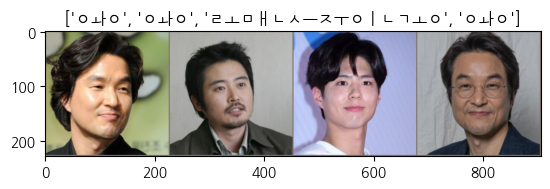

In [ ]:
iter_ = iter(train_dataloader)

data, labels = next(iter_)
out = torchvision.utils.make_grid(data)

imshow(out,title=[class_names[x] for x in labels])

## 모델 1. ResNet-34

In [ ]:
model = models.resnet34(pretrained = True) # 이미 학습된 가중치 가져와서 사용
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 81.0MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
#for param in model.parameters():
#    param.requires_grad = False

In [ ]:
fc_input_features = model.fc.in_features
fc_input_features

512

In [ ]:
model.fc = nn.Linear(fc_input_features, 3)

for name,module in model.named_parameters():
    print(name , module.requires_grad)

conv1.weight True
bn1.weight True
bn1.bias True
layer1.0.conv1.weight True
layer1.0.bn1.weight True
layer1.0.bn1.bias True
layer1.0.conv2.weight True
layer1.0.bn2.weight True
layer1.0.bn2.bias True
layer1.1.conv1.weight True
layer1.1.bn1.weight True
layer1.1.bn1.bias True
layer1.1.conv2.weight True
layer1.1.bn2.weight True
layer1.1.bn2.bias True
layer1.2.conv1.weight True
layer1.2.bn1.weight True
layer1.2.bn1.bias True
layer1.2.conv2.weight True
layer1.2.bn2.weight True
layer1.2.bn2.bias True
layer2.0.conv1.weight True
layer2.0.bn1.weight True
layer2.0.bn1.bias True
layer2.0.conv2.weight True
layer2.0.bn2.weight True
layer2.0.bn2.bias True
layer2.0.downsample.0.weight True
layer2.0.downsample.1.weight True
layer2.0.downsample.1.bias True
layer2.1.conv1.weight True
layer2.1.bn1.weight True
layer2.1.bn1.bias True
layer2.1.conv2.weight True
layer2.1.bn2.weight True
layer2.1.bn2.bias True
layer2.2.conv1.weight True
layer2.2.bn1.weight True
layer2.2.bn1.bias True
layer2.2.conv2.weight True


In [ ]:
optimizer = optim.Adam(model.parameters(), lr=1e-5)
model.to(device)
start_time = time.time()
for epoch in range(50):
    for data,labels in train_dataloader:
        optimizer.zero_grad()
        preds = model(data.to(device))
        loss = nn.CrossEntropyLoss()(preds,labels.to(device))
        loss.backward()
        optimizer.step()

    print(f'epoch : {epoch+1} loss : {loss.item()} time : {time.time() - start_time}')
    writer.add_scalar("Loss/train", loss.item(), epoch+1 )

epoch : 1 loss : 0.06611955910921097 time : 198.2113151550293
epoch : 2 loss : 0.12833046913146973 time : 207.1863193511963
epoch : 3 loss : 0.29387372732162476 time : 217.0919930934906
epoch : 4 loss : 0.01546928845345974 time : 226.89871644973755
epoch : 5 loss : 0.09729556739330292 time : 236.27178764343262
epoch : 6 loss : 0.006829122081398964 time : 245.9090073108673
epoch : 7 loss : 0.07779967784881592 time : 255.9253363609314
epoch : 8 loss : 0.007313992362469435 time : 265.6735944747925
epoch : 9 loss : 0.004905480891466141 time : 274.8815748691559
epoch : 10 loss : 0.10170350968837738 time : 284.66933488845825
epoch : 11 loss : 0.04109014570713043 time : 294.47308588027954
epoch : 12 loss : 0.015484852716326714 time : 303.5463922023773
epoch : 13 loss : 0.006859948858618736 time : 313.2589843273163
epoch : 14 loss : 0.03942345455288887 time : 323.11616611480713
epoch : 15 loss : 0.0018066311022266746 time : 333.45027208328247
epoch : 16 loss : 0.013868260197341442 time : 342.7

In [ ]:
torch.save(model, 'actor_resnet_model.pth')

In [ ]:
torch.save(model.state_dict(),'actor_resnet.pth')

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


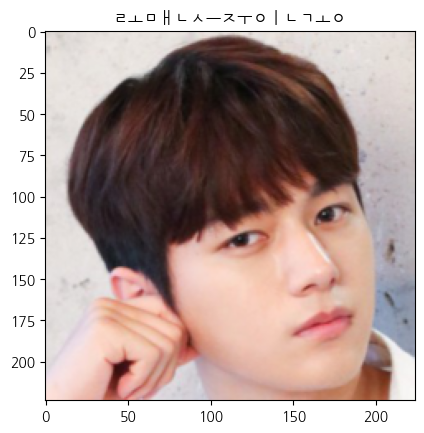

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


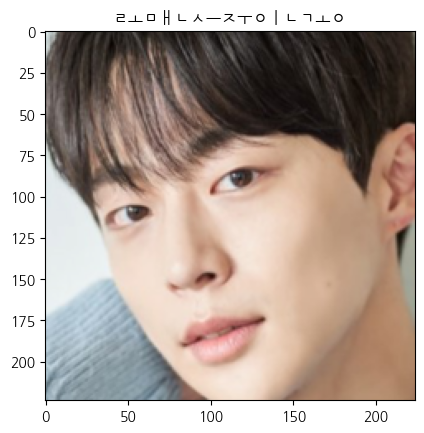

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


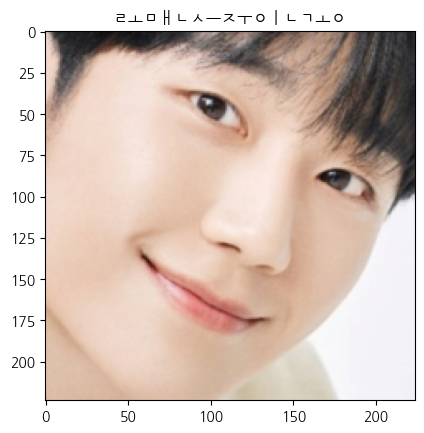

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


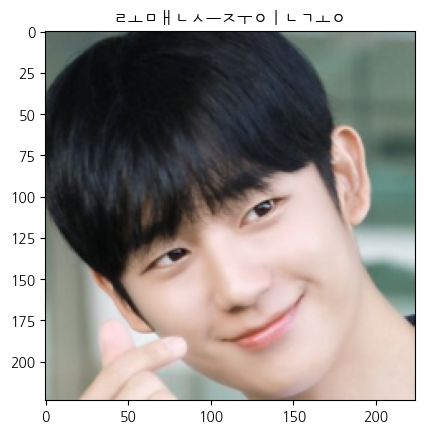

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


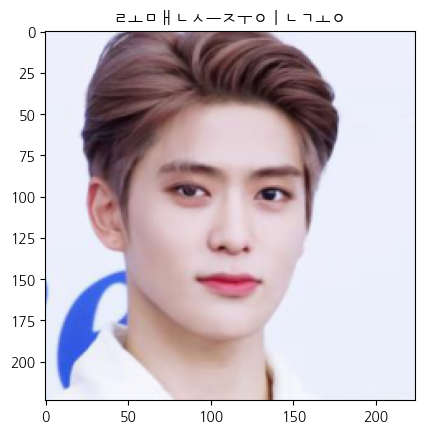

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


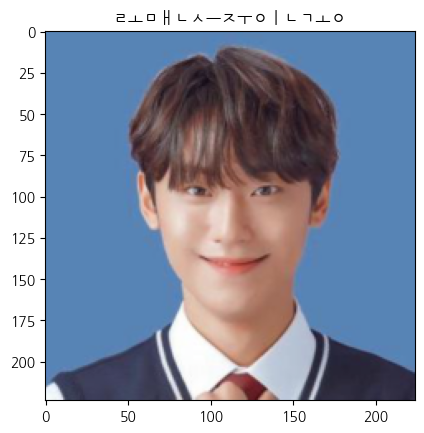

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


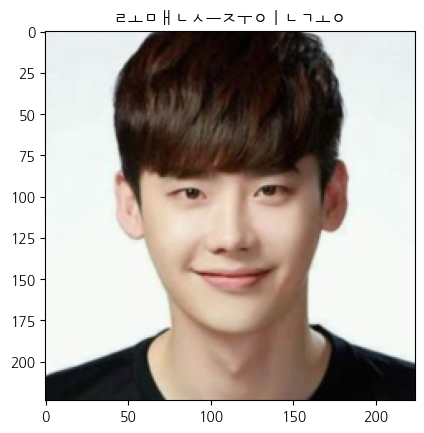

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


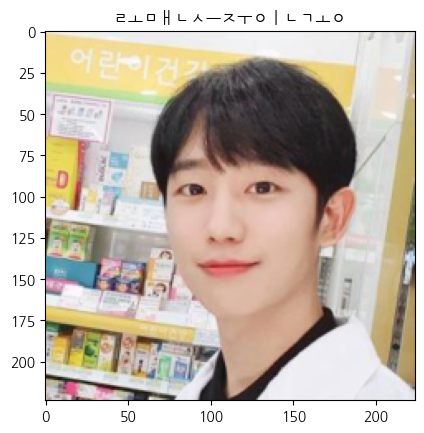

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


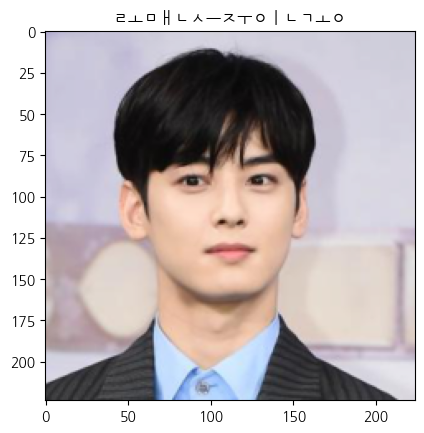

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


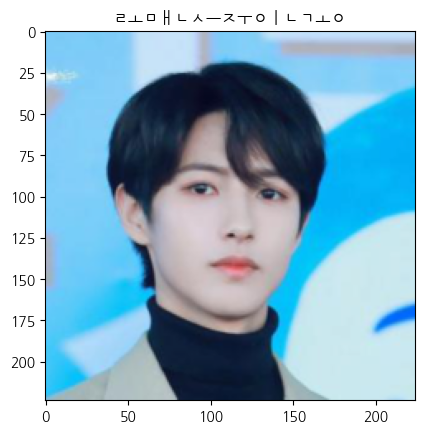

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


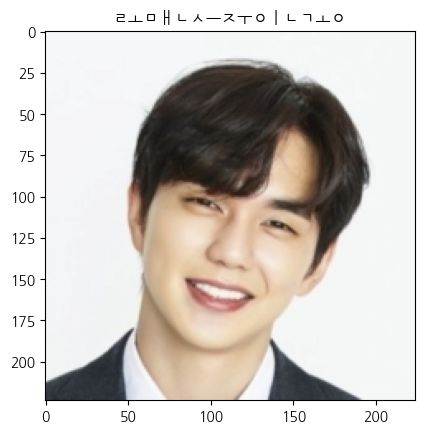

예측결과 : 악역, 실제정답: 로맨스주인공
(3, 224, 224)


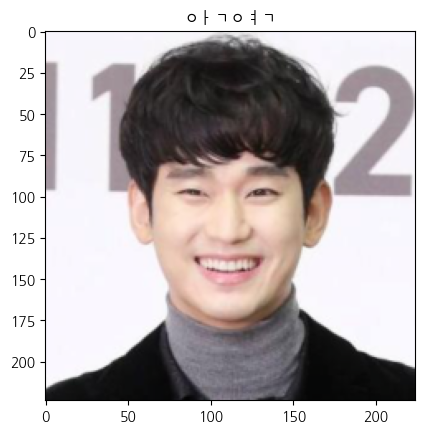

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


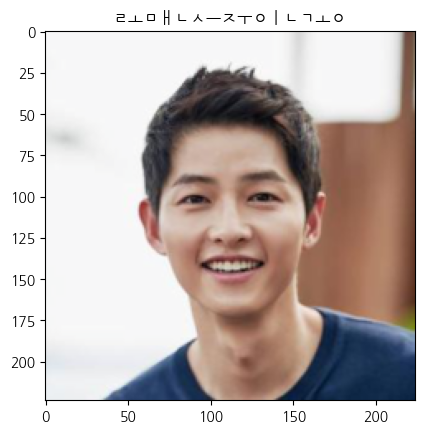

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


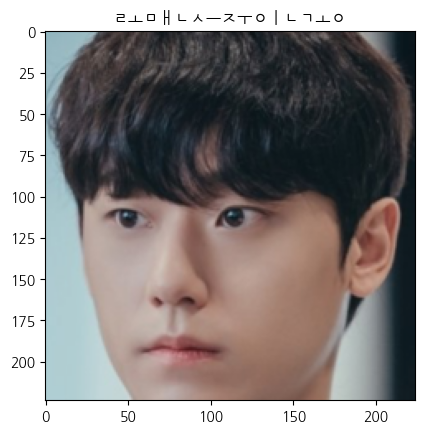

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


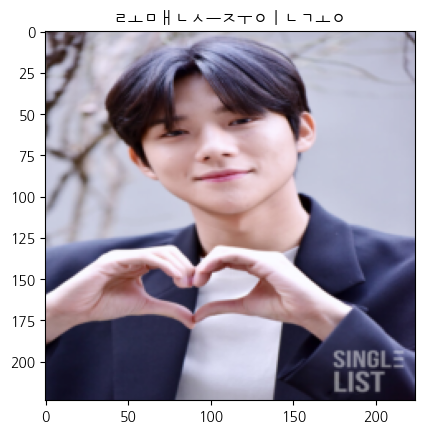

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


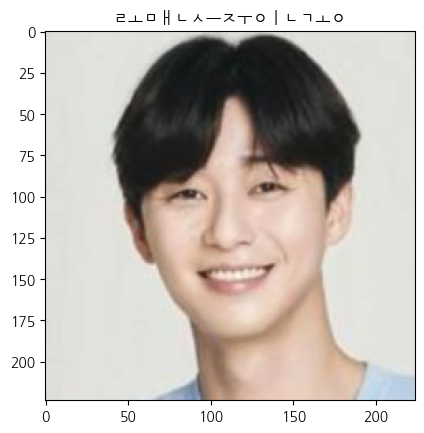

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


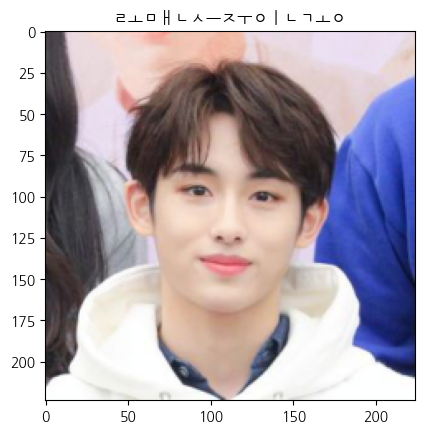

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


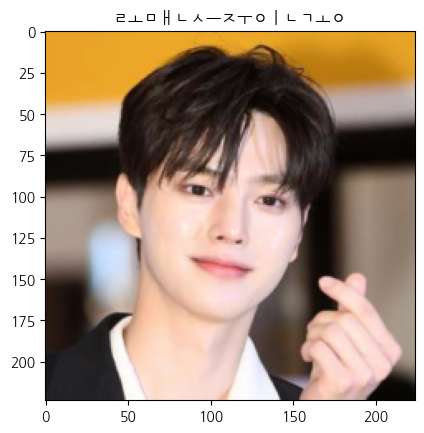

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


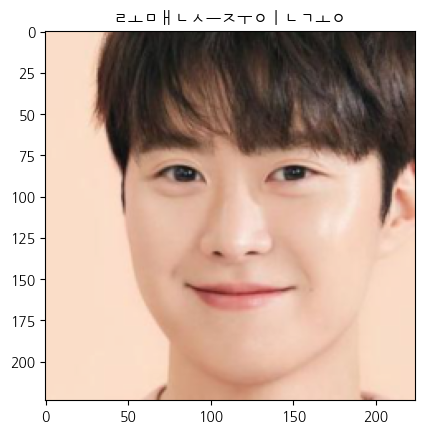

예측결과 : 로맨스주인공, 실제정답: 로맨스주인공
(3, 224, 224)


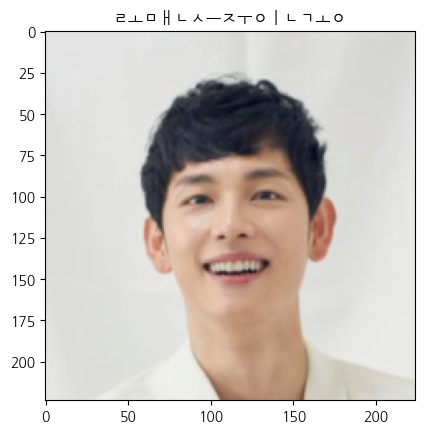

예측결과 : 왕, 실제정답: 악역
(3, 224, 224)


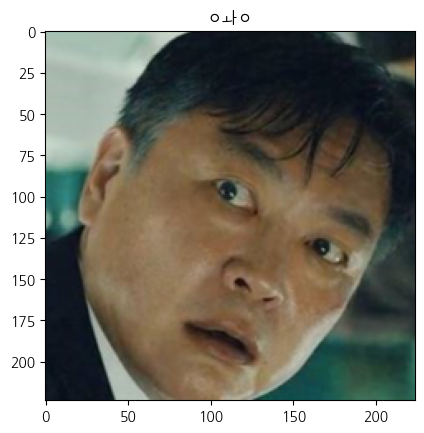

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


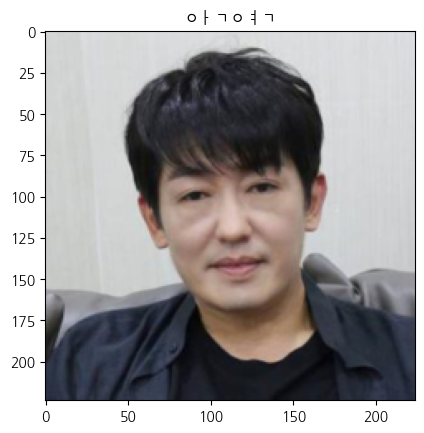

예측결과 : 로맨스주인공, 실제정답: 악역
(3, 224, 224)


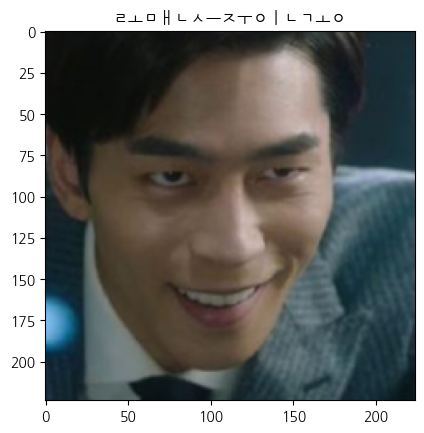

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


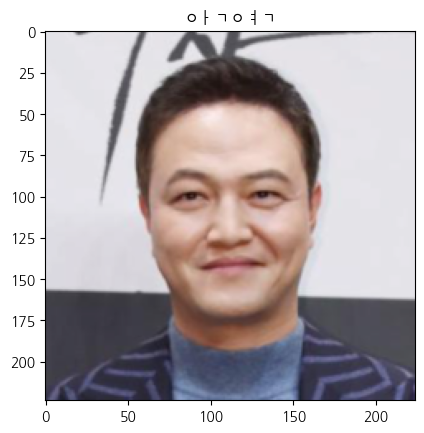

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


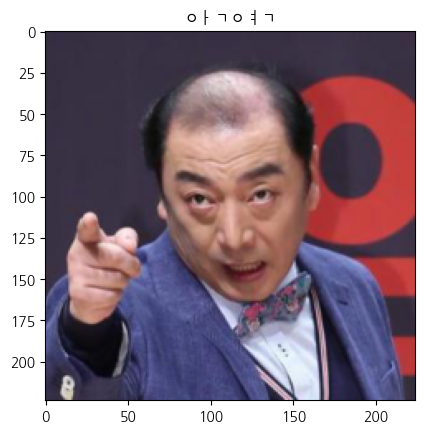

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


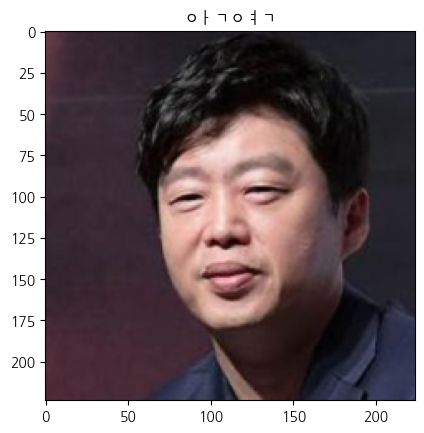

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


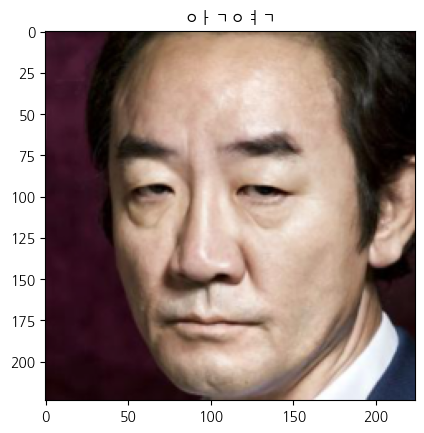

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


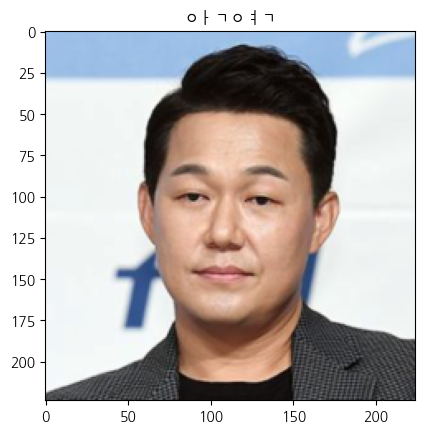

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


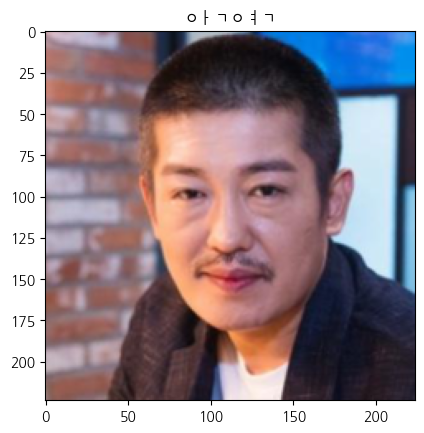

예측결과 : 왕, 실제정답: 악역
(3, 224, 224)


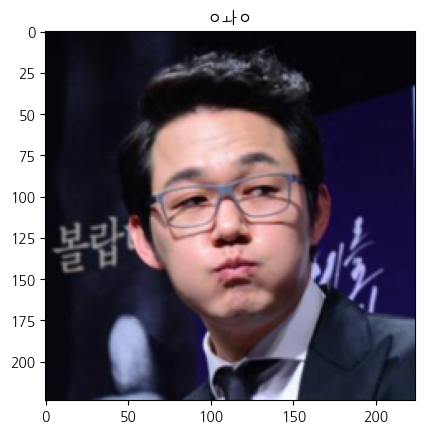

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


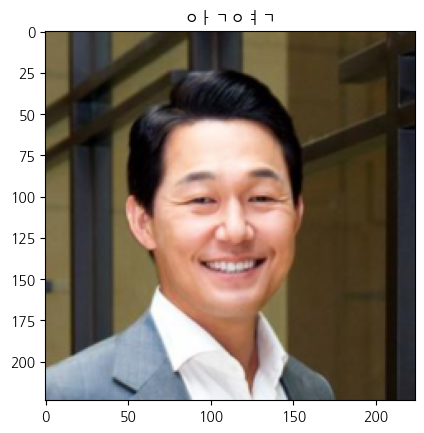

예측결과 : 왕, 실제정답: 악역
(3, 224, 224)


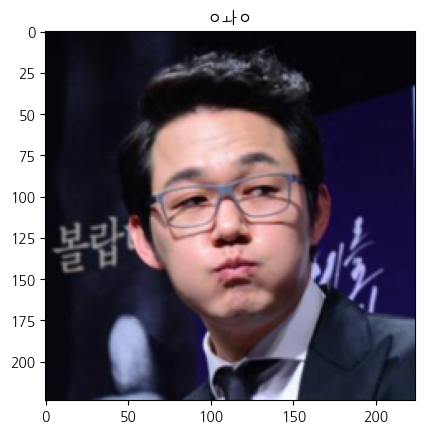

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


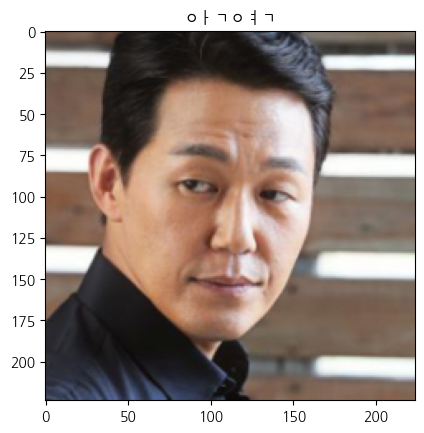

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


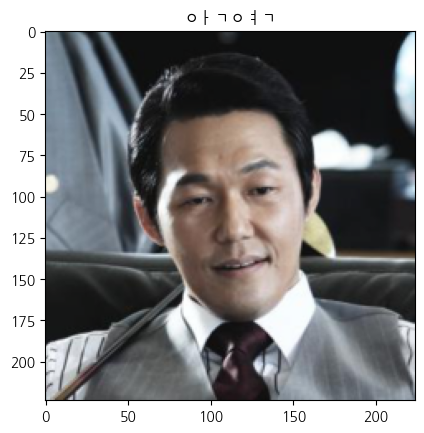

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


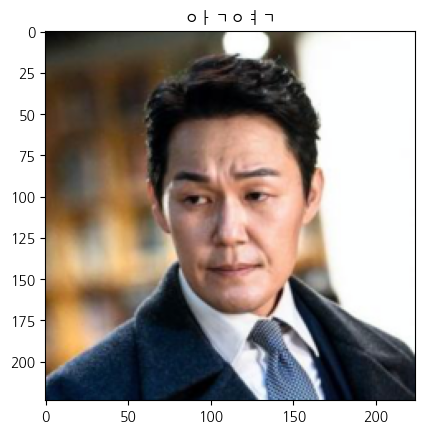

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


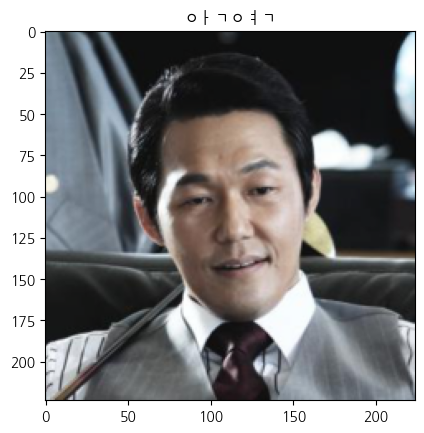

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


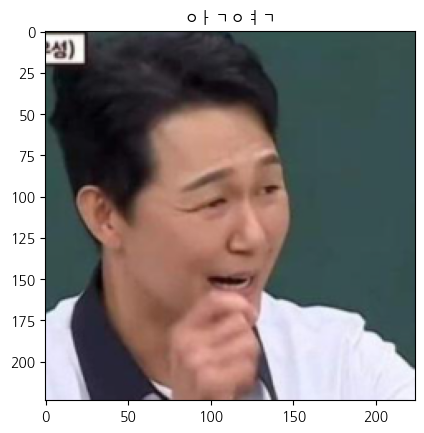

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


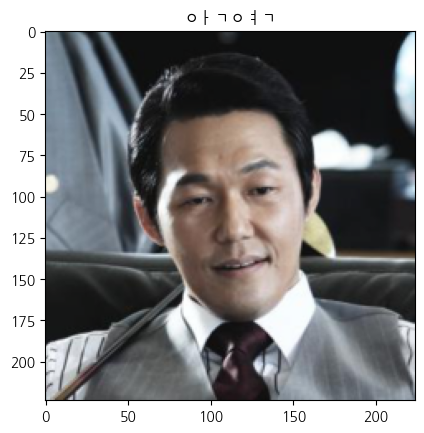

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


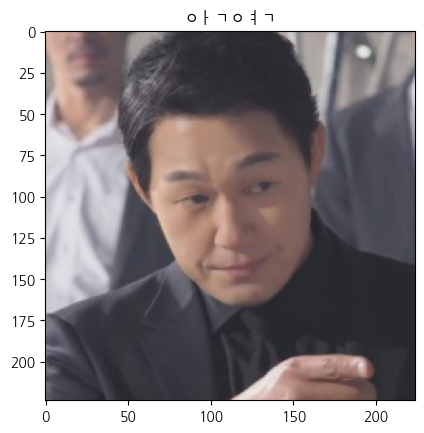

예측결과 : 악역, 실제정답: 악역
(3, 224, 224)


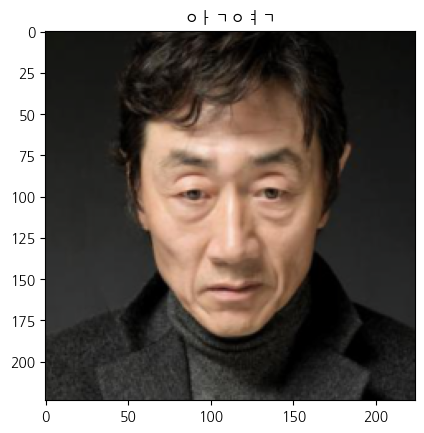

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


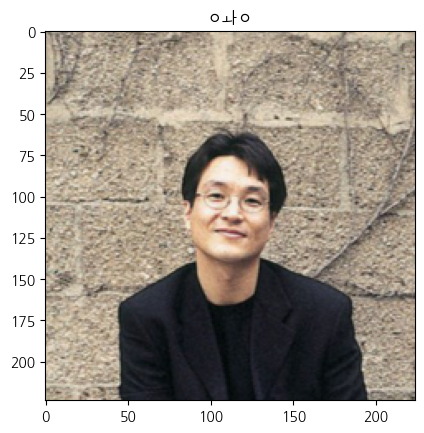

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


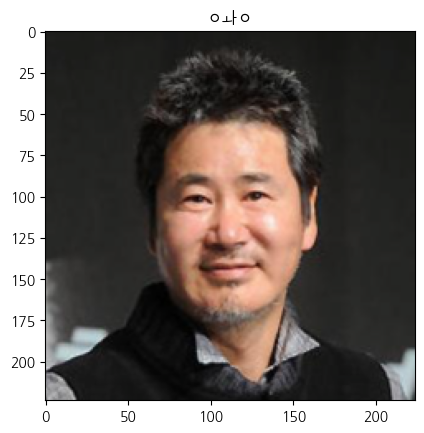

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


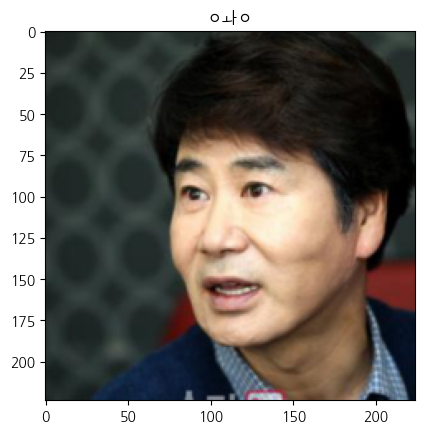

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


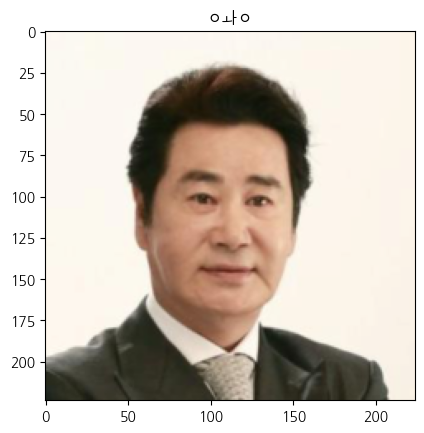

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


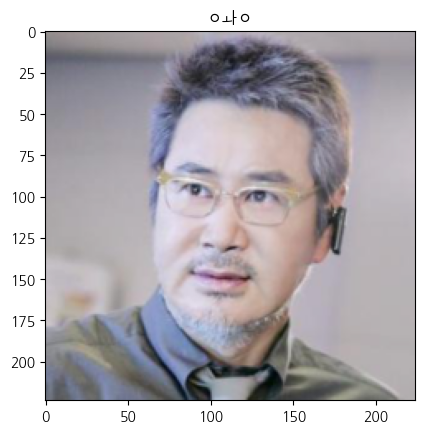

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


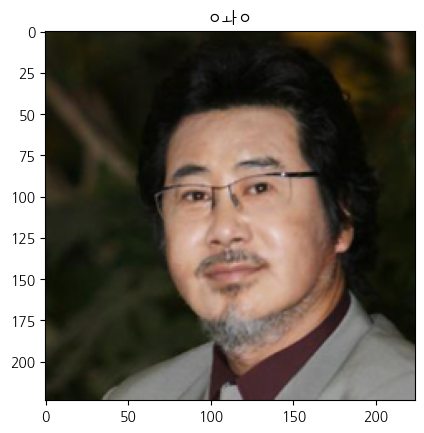

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


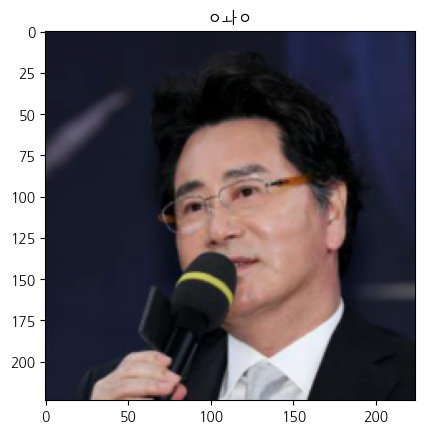

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


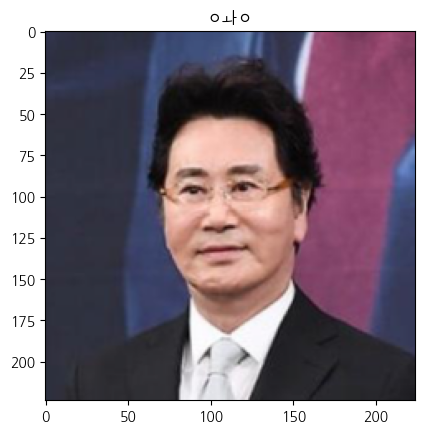

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


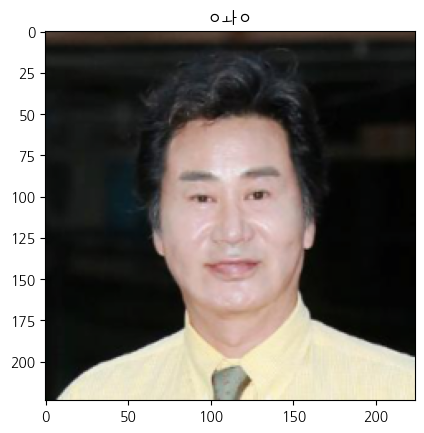

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


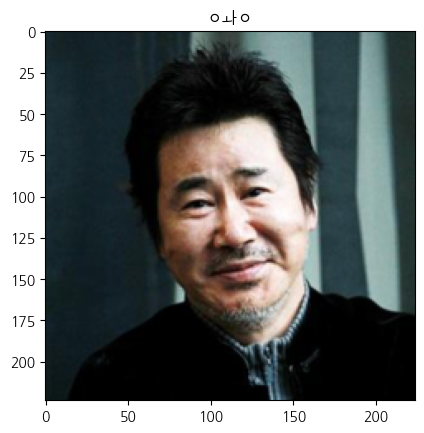

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


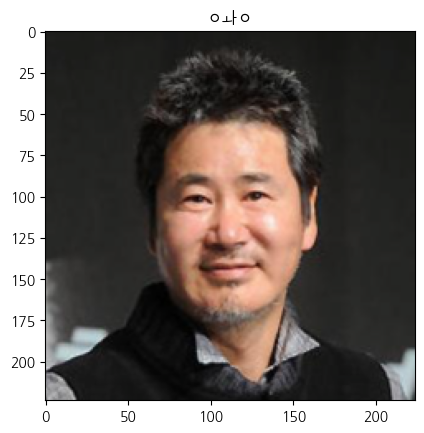

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


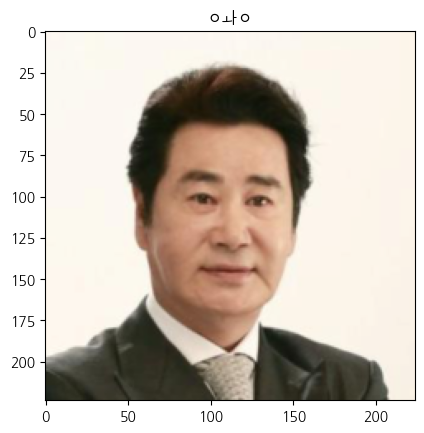

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


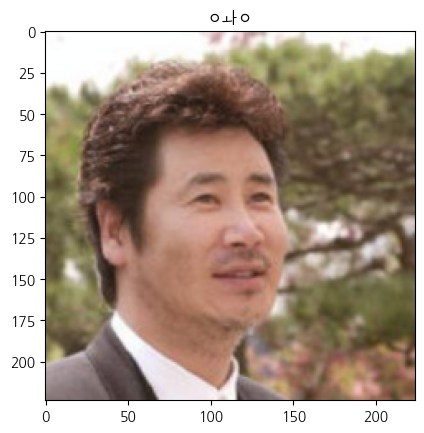

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


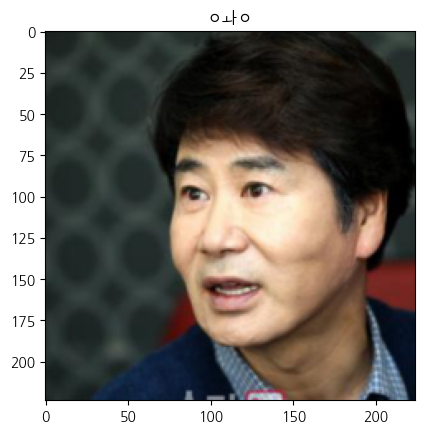

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


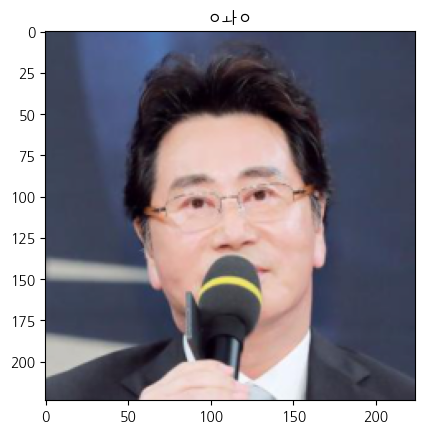

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


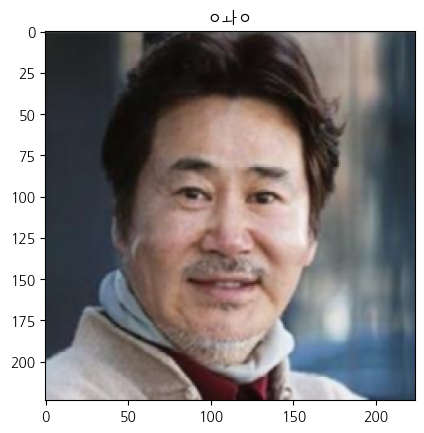

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


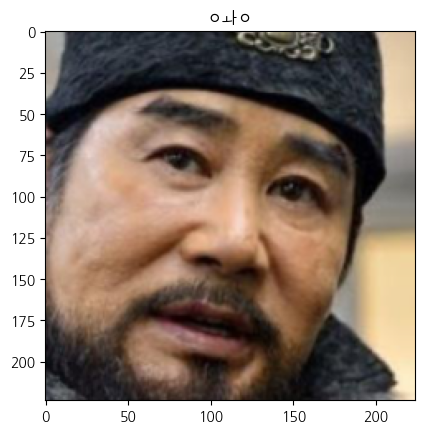

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


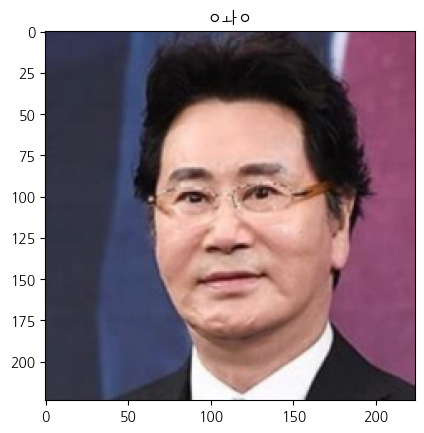

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


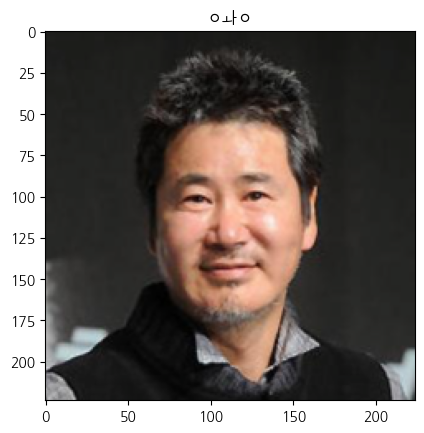

예측결과 : 왕, 실제정답: 왕
(3, 224, 224)


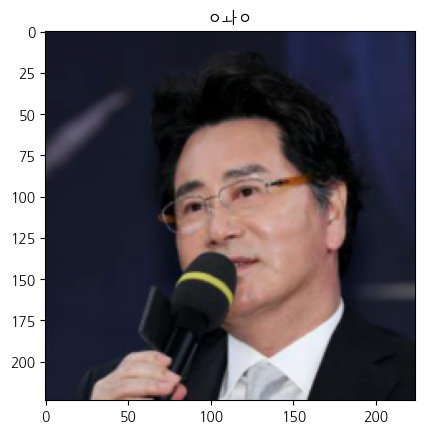

정확도 : 95.00000762939453


In [ ]:
model.eval()

with torch.no_grad():
  corrects = 0
  for data, labels in test_dataloader:
    preds = model(data.to(device))
    pred = torch.max(preds, 1)[1]

    corrects += torch.sum(pred == labels.to(device).data)

    print(f'예측결과 : {class_names[pred[0]]}, 실제정답: {class_names[labels.data[0]]}')
    imshow(data.cpu().data[0], title=class_names[pred[0]]) #데이터를 보여주기 위해서는 다시 cpu로 옮겨줘야함.

  acc = corrects / len(test_datasets) * 100
  print(f'정확도 : {acc}')

In [ ]:
# 쓰기 종료
writer.close()

#코랩 안에서 띄우기위함
%load_ext tensorboard
#경로로 불러오기
%tensorboard --logdir=runs
# %tensorboard --logdir [경로] --port [포트번호]

<IPython.core.display.Javascript object>